In [1]:
import os
import wave

In [2]:
def em_audio(af, string, output):
    print ("Please wait...")
    waveaudio = wave.open(af, mode='rb')
    frame_bytes = bytearray(list(waveaudio.readframes(waveaudio.getnframes())))
    string = string + int((len(frame_bytes)-(len(string)*8*8))/8) *'#'
    bits = list(map(int, ''.join([bin(ord(i)).lstrip('0b').rjust(8,'0') for i in string])))
    for i, bit in enumerate(bits):
        frame_bytes[i] = (frame_bytes[i] & 254) | bit
    frame_modified = bytes(frame_bytes)
    with wave.open(output, 'wb') as fd:
        fd.setparams(waveaudio.getparams())
        fd.writeframes(frame_modified)
    waveaudio.close()
    print ("Done...")

In [ ]:
em_audio('demo.wav','hello world','after.wav')

In [3]:
import IPython.display as ipd
import librosa
import librosa.display
import matplotlib.pyplot as plt

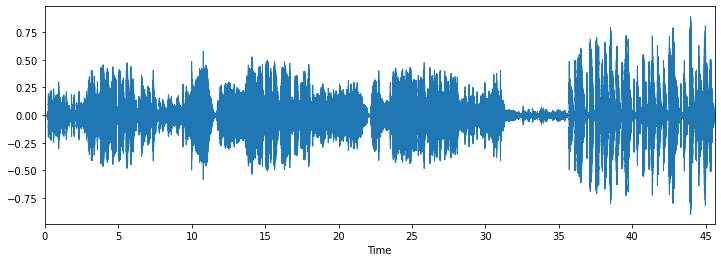

In [5]:
filename = 'demo.wav'
plt.figure(figsize=(12,4))
data,sample_rate = librosa.load(filename)
_ = librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(filename)

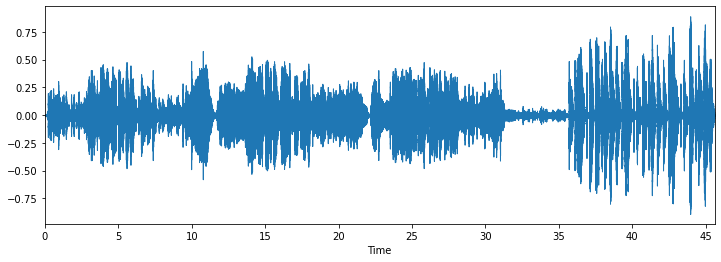

In [4]:
filename = 'after.wav'
plt.figure(figsize=(12,4))
data,sample_rate = librosa.load(filename)
_ = librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(filename)

timebins:  8553
freqbins:  513


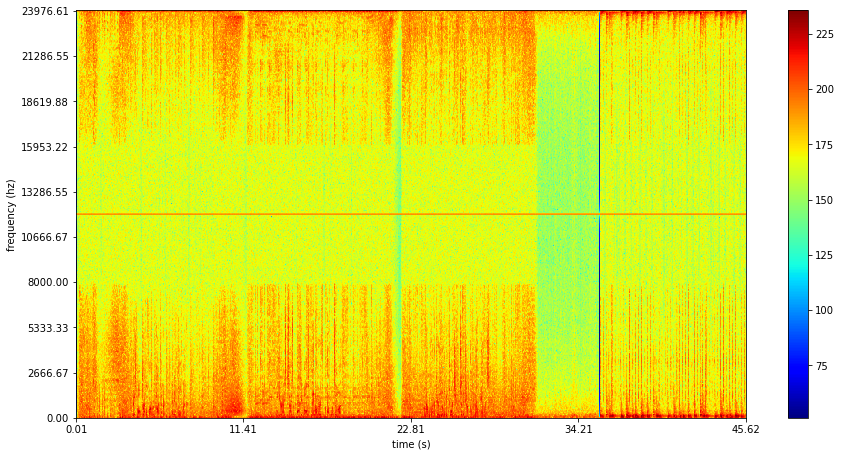

<Figure size 432x288 with 0 Axes>

In [8]:
import numpy as np
from matplotlib import pyplot as plt
import scipy.io.wavfile as wav
from numpy.lib import stride_tricks

""" short time fourier transform of audio signal """
def stft(sig, frameSize, overlapFac=0.5, window=np.hanning):
    win = window(frameSize)
    hopSize = int(frameSize - np.floor(overlapFac * frameSize))

    # zeros at beginning (thus center of 1st window should be for sample nr. 0)   
    samples = np.append(np.zeros(int(np.floor(frameSize/2.0))), sig)    
    # cols for windowing
    cols = np.ceil( (len(samples) - frameSize) / float(hopSize)) + 1
    # zeros at end (thus samples can be fully covered by frames)
    samples = np.append(samples, np.zeros(frameSize))

    frames = stride_tricks.as_strided(samples, shape=(int(cols), frameSize), strides=(samples.strides[0]*hopSize, samples.strides[0])).copy()
    frames *= win

    return np.fft.rfft(frames)    

""" scale frequency axis logarithmically """    
def logscale_spec(spec, sr=44100, factor=20.):
    timebins, freqbins = np.shape(spec)

    scale = np.linspace(0, 1, freqbins) ** factor
    scale *= (freqbins-1)/max(scale)
    scale = np.unique(np.round(scale))

    # create spectrogram with new freq bins
    newspec = np.complex128(np.zeros([timebins, len(scale)]))
    for i in range(0, len(scale)):        
        if i == len(scale)-1:
            newspec[:,i] = np.sum(spec[:,int(scale[i]):], axis=1)
        else:        
            newspec[:,i] = np.sum(spec[:,int(scale[i]):int(scale[i+1])], axis=1)

    # list center freq of bins
    allfreqs = np.abs(np.fft.fftfreq(freqbins*2, 1./sr)[:freqbins+1])
    freqs = []
    for i in range(0, len(scale)):
        if i == len(scale)-1:
            freqs += [np.mean(allfreqs[int(scale[i]):])]
        else:
            freqs += [np.mean(allfreqs[int(scale[i]):int(scale[i+1])])]

    return newspec, freqs

""" plot spectrogram"""
def plotstft(audiopath, binsize=2**10, plotpath=None, colormap="jet"):
    samplerate, samples = wav.read(audiopath)

    s = stft(samples, binsize)

    sshow, freq = logscale_spec(s, factor=1.0, sr=samplerate)

    ims = 20.*np.log10(np.abs(sshow)/10e-6) # amplitude to decibel

    timebins, freqbins = np.shape(ims)

    print("timebins: ", timebins)
    print("freqbins: ", freqbins)

    plt.figure(figsize=(15, 7.5))
    plt.imshow(np.transpose(ims), origin="lower", aspect="auto", cmap=colormap, interpolation="none")
    plt.colorbar()

    plt.xlabel("time (s)")
    plt.ylabel("frequency (hz)")
    plt.xlim([0, timebins-1])
    plt.ylim([0, freqbins])

    xlocs = np.float32(np.linspace(0, timebins-1, 5))
    plt.xticks(xlocs, ["%.02f" % l for l in ((xlocs*len(samples)/timebins)+(0.5*binsize))/samplerate])
    ylocs = np.int16(np.round(np.linspace(0, freqbins-1, 10)))
    plt.yticks(ylocs, ["%.02f" % freq[i] for i in ylocs])

    if plotpath:
        plt.savefig(plotpath, bbox_inches="tight")
    else:
        plt.show()

    plt.clf()

    return ims

ims = plotstft("after.wav")

In [9]:
import argparse
import math
from PIL import Image


def txt2rgb(text):
    # Add NULL bytes and new lines
    prepend = "\x00\r\n\r\n"
    formed_string = prepend + text + "\x00"

    pixel_len = math.ceil(len(formed_string) / 3)  # 3 rgb values per pixel
    width = math.ceil(math.sqrt(pixel_len))
    width = math.ceil(
        width / 4) * 4  # Make width a multiple of 4 to prevent a byte being added for the 4-byte alignment
    height = math.ceil(pixel_len / width)

    while len(formed_string) != (width * height * 3):  # Padding
        formed_string += "\x00"

    offset = 0
    matrix = [[0 for x in range(width)] for y in range(height)]
    for y in range(height - 1, -1, -1):  # Loop from the bottom to top
        for x in range(0, width):  # Loop from left to right
            r = ord(formed_string[offset + 2])
            g = ord(formed_string[offset + 1])
            b = ord(formed_string[offset])
            matrix[y][x] = (r, g, b)
            offset += 3

    return matrix


def matrix2rep(matrix):
    height = len(matrix)
    width = len(matrix[0])
    representation = "Width={}, height={}\n".format(width, height)
    for y in range(height):
        for x in range(width):
            r, g, b = matrix[y][x]
            representation += "rgb({0: >3}, {1: >3}, {2: >3})  ".format(r, g, b)
        representation += "\n"
    return representation


def matrix2bmp(matrix, filename):
    height = len(matrix)
    width = len(matrix[0])
    im = Image.new("RGB", (width, height))
    pixels = im.load()

    for y in range(height):
        for x in range(width):
            pixels[x, y] = matrix[y][x]

    try:
        im.save(filename, "bmp")
    except:
        return False
    return True


def get_text(args):
    if args.input is not None:
        return args.input
    else:
        try:
            with open(args.file, "r") as f:
                return f.read()
        except:
            print("Can't read file.")
            return False


def main():
    argument_parser = argparse.ArgumentParser(description="Convert text to bmp.")
    group = argument_parser.add_mutually_exclusive_group(required=True)
    group.add_argument("-i", "--input", type=str, help="Input text from cli")
    group.add_argument("-f", "--file", type=str, help="Input text from file")
    argument_parser.add_argument("-b", "--bitmap", type=str, help="Save image as bitmap")
    argument_parser.add_argument("-t", "--text", type=str, help="Save rgb values to file")
    argument_parser.add_argument("-p", "--pixels", action="store_true", help="Print RGB values")
    args = argument_parser.parse_args()

    text = get_text(args)

    if text is not False:
        matrix = txt2rgb(text)
        if args.bitmap is not None:
            if matrix2bmp(matrix, args.bitmap):
                print("Saved as bitmap in: {}".format(args.bitmap))
            else:
                print("Failed to save as bitmap...")
        elif args.text is not None:
            try:
                with open(args.text, "w") as f:
                    f.write(matrix2rep(matrix))
                print("Saved as text in: {}".format(args.text))
            except:
                print("Failed to save as text...")
        else:
            print(matrix2rep(matrix))


if __name__ == "__main__":
    main()

Width=12, height=8
rgb(101, 110, 114)  rgb(110,  95, 108)  rgb(101, 109,  97)  rgb( 32,  58,  34)  rgb( 10,  34,  34)  rgb(  0,   0, 125)  rgb(  0,   0,   0)  rgb(  0,   0,   0)  rgb(  0,   0,   0)  rgb(  0,   0,   0)  rgb(  0,   0,   0)  rgb(  0,   0,   0)  
rgb(116,  97, 110)  rgb(101, 114, 117)  rgb( 99, 115,  95)  rgb(109, 101, 104)  rgb( 58,  34, 101)  rgb(104,  34,  32)  rgb( 99,  97, 109)  rgb(104, 115,  45)  rgb( 53,  50,  97)  rgb( 44,  34,  54)  rgb( 32,  32,  10)  rgb(101, 107,  34)  
rgb(100,  50,  97)  rgb( 34, 102,  54)  rgb( 32,  10,  44)  rgb(116,  34,  32)  rgb(110,  97, 114)  rgb(111, 112, 115)  rgb( 34, 116, 114)  rgb( 34,  32,  58)  rgb(112,  99, 116)  rgb( 10,  44,  34)  rgb( 34,  32,  32)  rgb(103, 105, 115)  
rgb(101, 107,  34)  rgb( 58,  34, 121)  rgb(101,  34,  32)  rgb( 56,  51,  50)  rgb( 57,  48, 101)  rgb( 55,  45, 100)  rgb(101,  57,  57)  rgb( 55,  55,  52)  rgb( 52,  99, 101)  rgb( 48,  50,  55)  rgb( 55,  53,  53)  rgb( 57, 100,  51)  
rgb(116, 114, 111

In [28]:
from PIL import Image, ImageDraw, ImageFont

fontsize=12
font = ImageFont.truetype("arial.ttf", fontsize)
img = Image.new('L', (100, 10))
d = ImageDraw.Draw(img)
d.text((1,1), "SCIENCE",255,font=font)
img.save('pil_text.png')